#PDF and Image Content Extraction for LLMs

In [4]:
# pip install -U pypdfium2
!pip install matplotlib

In [1]:
import pypdfium2 as pdfium
import matplotlib.pyplot as plt
from PIL import Image
from io import BytesIO

In [2]:
def convert_pdf_to_images(file_path, scale = 300/72):
  pdf_file = pdfium.PdfDocument(file_path)
  page_indices = [i for i in range(len(pdf_file))]

  renderer = pdf_file.render(
      pdfium.PdfBitmap.to_pil,
      page_indices=page_indices,
      scale =scale,
  )

  list_final_images = []

  for i, image in zip(page_indices, renderer):

    image_byte_array = BytesIO()
    image.save(image_byte_array,format = 'jpeg',optimize = True)
    image_byte_array = image_byte_array.getvalue()
    list_final_images.append(dict({i:image_byte_array}))
  return list_final_images


In [3]:
def display_images(list_dict_final_images):
  all_images = [list(data.values())[0] for data in list_dict_final_images]

  for index, images_bytes in enumerate(all_images):

    image = Image.open(BytesIO(images_bytes))
    figure = plt.figure(figsize=(image.width/100 , image.height/100))

    plt.title(f"----------------page Number: {index +1}---------------")
    plt.imshow(image)
    plt.axis("off")
    plt.show()

In [4]:
Convert_pdf_to_images = convert_pdf_to_images("/content/Papers/2310.14393v1.pdf")

In [5]:
Convert_pdf_to_images[1]

{1: b'\xff\xd8\xff\xe0\x00\x10JFIF\x00\x01\x01\x00\x00\x01\x00\x01\x00\x00\xff\xdb\x00C\x00\x08\x06\x06\x07\x06\x05\x08\x07\x07\x07\t\t\x08\n\x0c\x14\r\x0c\x0b\x0b\x0c\x19\x12\x13\x0f\x14\x1d\x1a\x1f\x1e\x1d\x1a\x1c\x1c $.\' ",#\x1c\x1c(7),01444\x1f\'9=82<.342\xff\xdb\x00C\x01\t\t\t\x0c\x0b\x0c\x18\r\r\x182!\x1c!22222222222222222222222222222222222222222222222222\xff\xc0\x00\x11\x08\r\xb4\t\xb1\x03\x01"\x00\x02\x11\x01\x03\x11\x01\xff\xc4\x00\x1c\x00\x01\x00\x03\x01\x01\x01\x01\x01\x00\x00\x00\x00\x00\x00\x00\x00\x00\x05\x06\x07\x04\x03\x08\x02\x01\xff\xc4\x00j\x10\x00\x01\x03\x04\x00\x04\x02\x07\x02\t\x06\t\x05\x0c\x00\x17\x01\x00\x02\x03\x04\x05\x06\x11\x07\x12!1\x13A\x08\x14"Qaq\x812\x91\x15#7BRt\xa1\xb1\xb2\x1636rs\xb3\x17$58b\x82\x92\xc1\xc24u\x83\xa2\xd1\x18%CSUV\x84\x93\x94\xd2\xd3\xe1\xf0&DTc\x95\xc3\'d\xb4\xc4\xf1W\xa3\xa4(FHeE\x85\xe2G\xff\xc4\x00\x19\x01\x01\x00\x03\x01\x01\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x01\x02\x03\x04\x05\xff\xc4\x009\x11\x01\x00\x02\x02\x0

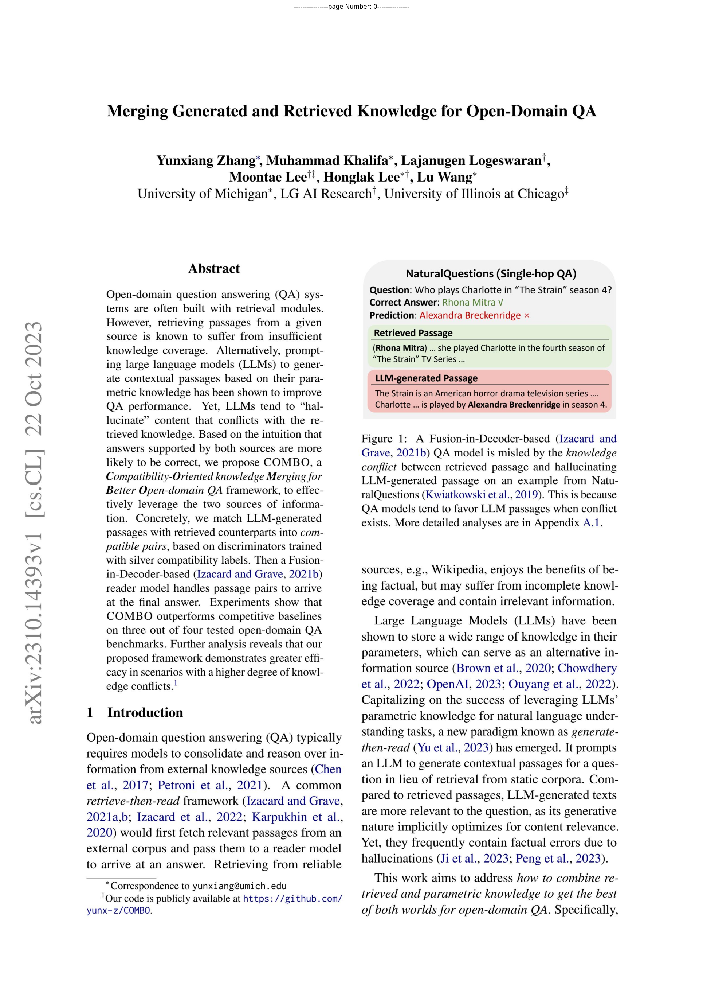

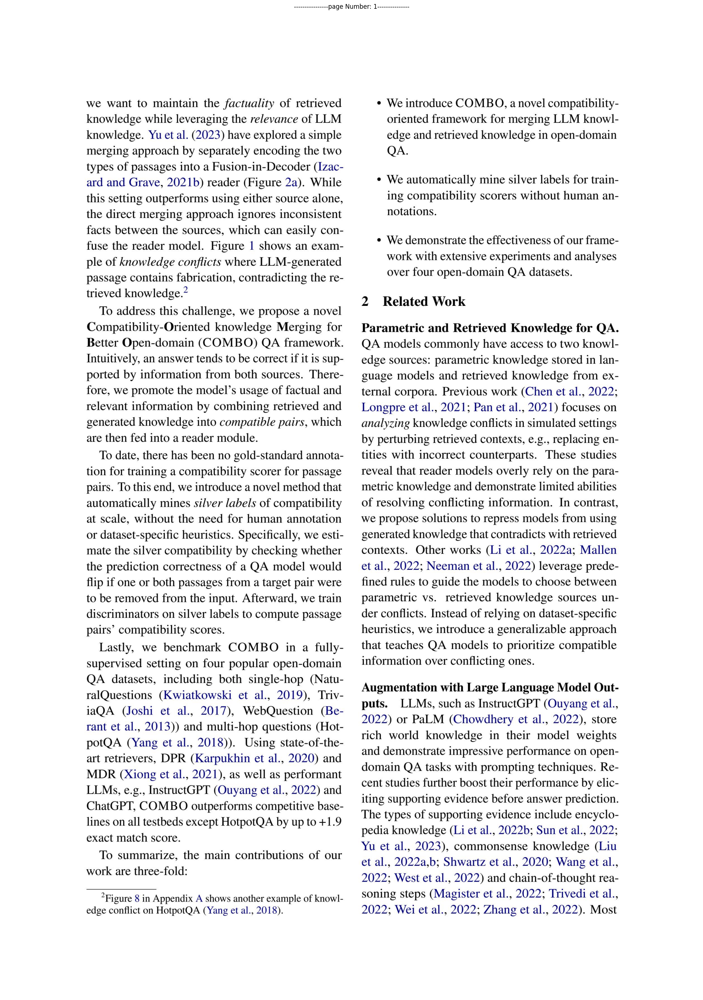

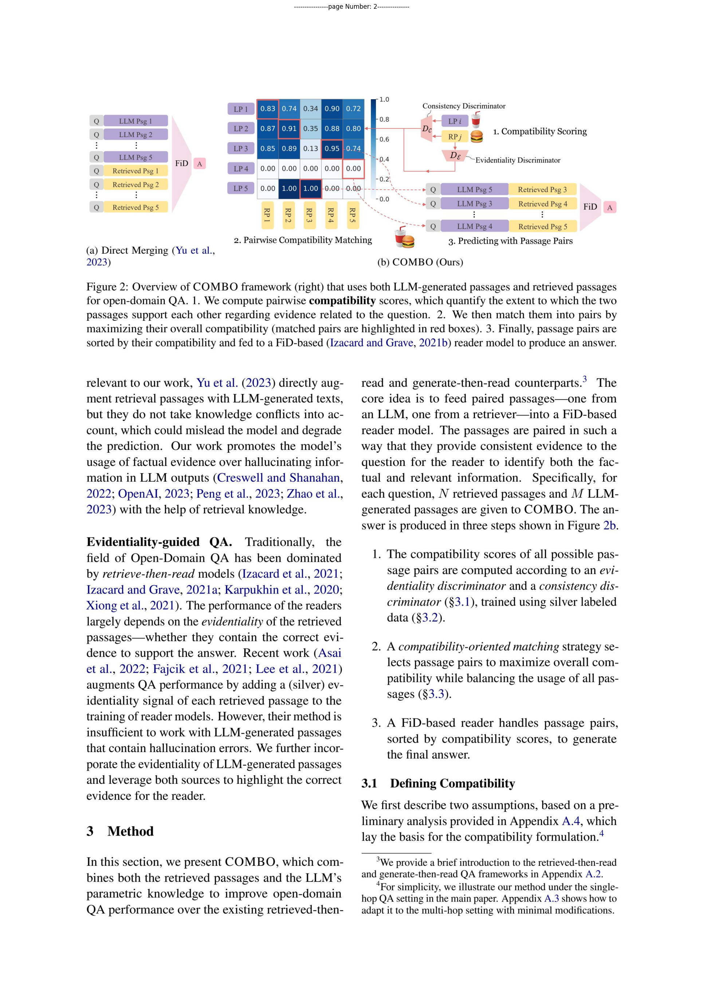

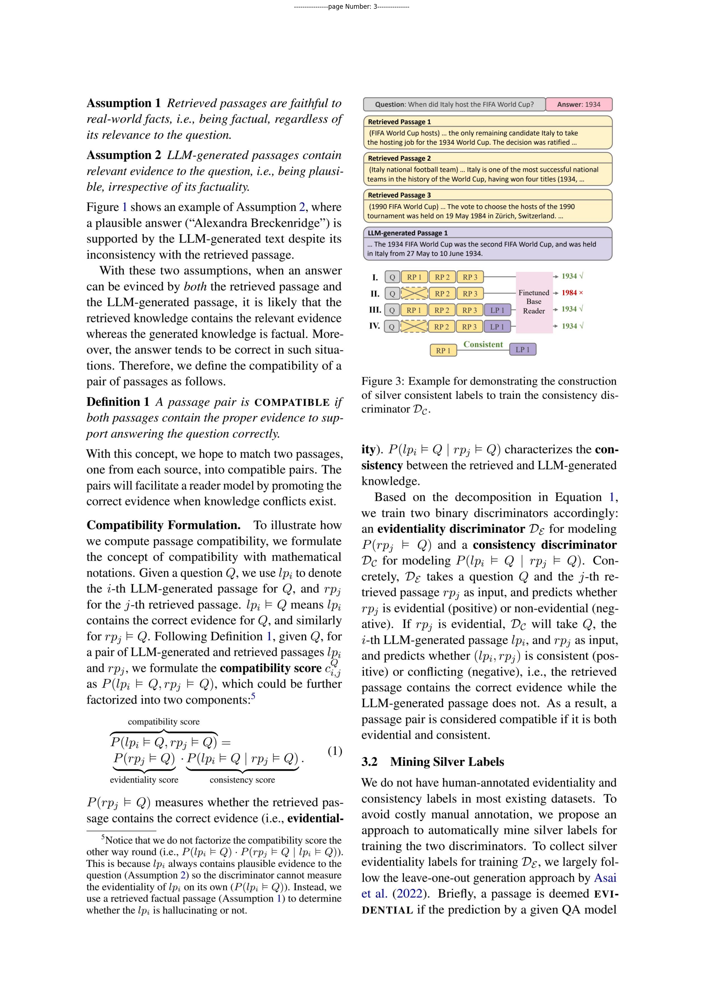

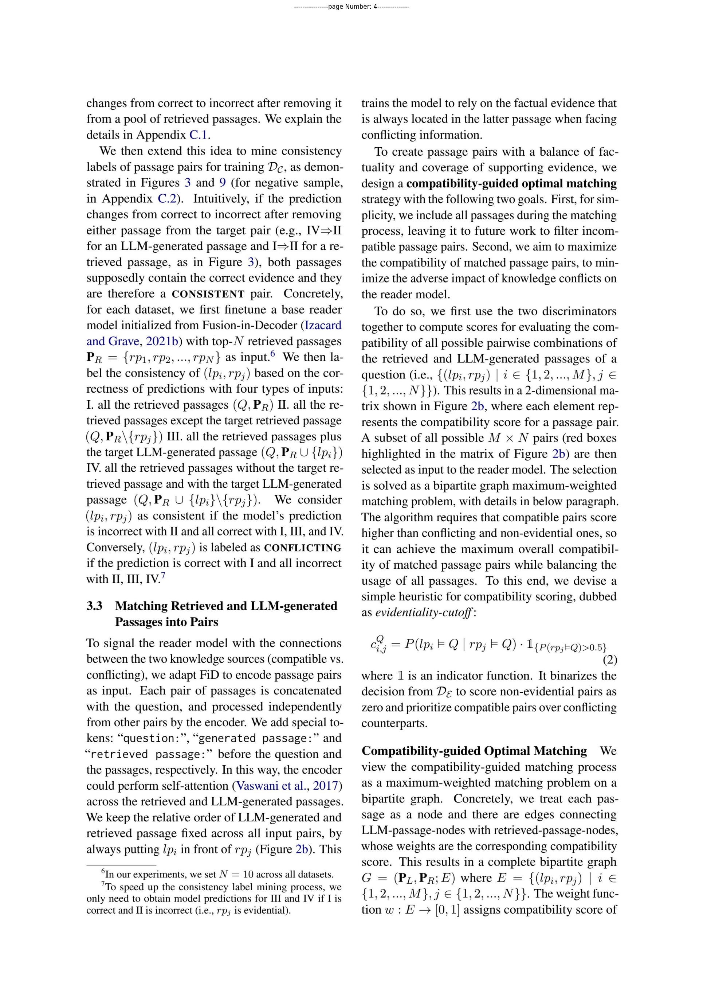

KeyboardInterrupt: 

In [20]:
display_images(Convert_pdf_to_images)

#Using Langchain to extract the data

In [27]:
!pip install "unstructured[pdf]"
!pip install unstructured_pytesseract

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 117.0/117.0 kB 11.1 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 112.5/112.5 kB 10.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 523.4/523.4 kB 26.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.4/2.4 MB 73.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 79.5/79.5 kB 7.0 MB/s eta 0:00:00
  Created wheel for antlr4-python3-runtime: filename=antlr4_python3_runtime-4.9.3-py3-none-any.whl size=144555 sha256=6062ec7563d7c5657dbfec8cddcb8395aa615bf90ad28ff19062a29f0e9fac25
  Stored in directory: /root/.cache/pip/wheels/1a/97/32/461f837398029ad76911109f07047fde1d7b661a147c7c56d1
Successfully built antlr4-python3-runtime


In [20]:
# !pip install langchain
# !pip -q install unstructured
# !pip install -U "pdfminer.six<20221105"
# !pip install pi-heif
# !pip install unstructured_inference
!pip install pdf2image

In [6]:
import os
from PIL import Image
from io import BytesIO
from tempfile import NamedTemporaryFile
from langchain.document_loaders.image import UnstructuredImageLoader

def extract_text_with_langchain(list_dict_final_images):
    image_content = []

    for index, image_dict in enumerate(list_dict_final_images):
        image_bytes = list(image_dict.values())[0]
        image = Image.open(BytesIO(image_bytes))

        # Save image to a temporary file
        with NamedTemporaryFile(delete=True, suffix=".jpg") as temp_file:
            image.save(temp_file.name, format="JPEG")
            temp_file.flush()  # Ensure the file is written

            # Process with UnstructuredImageLoader
            loader = UnstructuredImageLoader(temp_file.name)  # Pass file path
            data = loader.load()
            raw_text = data[0].page_content  # Assuming single-page output

            image_content.append(raw_text)

    return "\n".join(image_content)



In [8]:
!sudo apt update
!sudo apt install -y tesseract-ocr


Hit:1 http://archive.ubuntu.com/ubuntu jammy InRelease
Get:2 http://archive.ubuntu.com/ubuntu jammy-updates InRelease [128 kB]
Get:3 https://cloud.r-project.org/bin/linux/ubuntu jammy-cran40/ InRelease [3,632 B]
Get:4 https://developer.download.nvidia.com/compute/cuda/repos/ubuntu2204/x86_64  InRelease [1,581 B]
Get:5 http://archive.ubuntu.com/ubuntu jammy-backports InRelease [127 kB]
Get:6 http://security.ubuntu.com/ubuntu jammy-security InRelease [129 kB]
Get:7 https://r2u.stat.illinois.edu/ubuntu jammy InRelease [6,555 B]
Hit:8 https://ppa.launchpadcontent.net/deadsnakes/ppa/ubuntu jammy InRelease
Hit:9 https://ppa.launchpadcontent.net/graphics-drivers/ppa/ubuntu jammy InRelease
Get:10 http://archive.ubuntu.com/ubuntu jammy-updates/universe amd64 Packages [1,526 kB]
Hit:11 https://ppa.launchpadcontent.net/ubuntugis/ppa/ubuntu jammy InRelease
Get:12 https://developer.download.nvidia.com/compute/cuda/repos/ubuntu2204/x86_64  Packages [1,315 kB]
Get:13 http://archive.ubuntu.com/ubuntu 

In [9]:
text_with_langchain_image = extract_text_with_langchain(Convert_pdf_to_images)
print(text_with_langchain_image)


2023

arXiv:2310.14393v1 [cs.CL] 22 Oct

Merging Generated and Retrieved Knowledge for Open-Domain QA

Yunxiang Zhang*, Muhammad Khalifa*, Lajanugen Logeswaran', Moontae Lee'?, Honglak Lee*', Lu Wang*

University of Michigan*, LG AI Research’, University of Illinois at Chicago?

Abstract

NaturalQuestions (Single-hop QA)

Open-domain question answering (QA) sys- tems are often built with retrieval modules. However, retrieving passages from a given source is known to suffer from insufficient knowledge coverage. Alternatively, prompt- ing large language models (LLMs) to gener- ate contextual passages based on their para- metric knowledge has been shown to improve QA performance. Yet, LLMs tend to “hal- lucinate” content that conflicts with the re- trieved knowledge. Based on the intuition that answers supported by both sources are more likely to be correct, we propose COMBO, a Compatibility-Oriented knowledge Merging for Better Open-domain QA framework, to effec- tively leverage the two 

In [10]:
from langchain_community.document_loaders import UnstructuredFileLoader

def extract_text_with_langchain_pdf(pdf_file):

    loader = UnstructuredFileLoader(pdf_file)
    documents = loader.load()
    pdf_pages_content = '\n'.join(doc.page_content for doc in documents)

    return pdf_pages_content


In [11]:
text_with_langchain_pdf = extract_text_with_langchain_pdf("/content/Papers/2310.14393v1.pdf")


<ipython-input-10-1ccd807c699f>:5: LangChainDeprecationWarning: The class `UnstructuredFileLoader` was deprecated in LangChain 0.2.8 and will be removed in 1.0. An updated version of the class exists in the :class:`~langchain-unstructured package and should be used instead. To use it run `pip install -U :class:`~langchain-unstructured` and import as `from :class:`~langchain_unstructured import UnstructuredLoader``.
  loader = UnstructuredFileLoader(pdf_file)


In [12]:
print(text_with_langchain_pdf)

3 2 0 2

t c O 2 2

] L C . s c [

1 v 3 9 3 4 1 . 0 1 3 2 : v i X r a

Merging Generated and Retrieved Knowledge for Open-Domain QA

NaturalQuestions(Single-hopQA)Question:Who plays Charlotte in “The Strain” season 4?CorrectAnswer:Rhona Mitra√Prediction:Alexandra Breckenridge ×HotpotQA(Multi-hopQA)Question:Gail Matthiusco-anchored the Weekend Update segment of "Saturday Night Live" with the actor who played the villain Nicholas Andre in what movie? Answer:Dumb and Dumber√Prediction:The Goonies ×

LLM-generatedPassageThe Strain is an American horror drama television series …. Charlotte …is played by Alexandra Breckenridge in season 4.

1.Gail Matthiusis an American actress … She also co-anchored the Weekend Update segment of the show "Saturday Night Live" …2.Robert Davi… is perhaps best known for his roles in movies such as … "The Goonies” … where he played the character Nicholas Andre.LLM-generatedPassage

RetrievedPassage(Rhona Mitra) …she played Charlotte in the fourth season of “Th